In [1]:
import numpy as np
import pandas as pd
import cv2
import os
from tqdm import tqdm
import matplotlib.pyplot as plt
from matplotlib.pyplot import imread
import glob

# Load Images from Video

In [17]:
def display_images(X, start_idx=0, end_idx=None,  step_val=1, 
                   columns = 5, use_gray=False, 
                   apply_fnc=None, figsize=(32,18)):
    """
    Display a set of images
    Parameters
    ----------
    X: numpy array of images
         Images to be displayed
    start_idx: int
         Start index for images
    end_idx: int
         End index for images
    step_val: int
        step value
    columns: int
         Number of columns of images
    use_gray: bool
         True for RGB images.  False for grayscale images.
    apply_fnc: function
         An function to apply to each image before displaying.
    figsize: tuple of int
         Display height and width of images.
    """
    if end_idx is None:
        end_idx = X.shape[0]
        
    if apply_fnc is None:
        apply_fnc = lambda image: image
        
    plt.figure(figsize=figsize)

    num_of_images = end_idx - start_idx
    rows = num_of_images / columns + 1
    
    cnt = 0
    for i in range(start_idx, end_idx, step_val):
        cnt += 1
        image = X[i]
        
        _cnt = cnt % num_of_images
        plt.subplot(rows, columns, _cnt)
        
        if use_gray:
            plt.imshow(apply_fnc(image), cmap="gray")
        else:
            plt.imshow(apply_fnc(image)) 
            
    plt.tight_layout()
            
    plt.show()

In [18]:
def read_imgs(file_names):
    """
    Read list of images from disk.
    Parameters
    ----------
    file_names: list of str
         List of image file names.
    Returns
    -------
    numpy array of images:
         Images from disk.
    """
    img_arr = []
    
    for file_name in file_names:
        img = imread(file_name)
        img_arr.append(img)
        
    return np.stack(img_arr)

In [19]:
def pad_zeros(val, num_of_zeros=7):
    pad_str = '{:0>%d}' % num_of_zeros
    return pad_str.format(val)

In [20]:
pad_zeros(0)

'0000000'

In [21]:
def extract_video_imgs(video, output_dir):
    os.makedirs(output_dir, exist_ok=True)
    
    vidcap = cv2.VideoCapture(video)
    length = int(vidcap.get(cv2.CAP_PROP_FRAME_COUNT))
    
    success,image = vidcap.read()
    for i in tqdm(range(length)):
        if success:
            success, image = vidcap.read()
        
            frame_file = "%s/frame_%s.jpg" % (output_dir, pad_zeros(i))
            cv2.imwrite(frame_file, image)     # save frame as JPEG file
        else:
            print("WARNING: frame #%d could not be read. Stopping.")
            break

In [22]:
data_dir = 'data'

In [23]:
video = 'project_video.mp4'
output_dir = '%s/project_video' % data_dir
extract_video_imgs(video, output_dir)

100%|██████████| 1260/1260 [02:04<00:00, 10.15it/s]


In [24]:
video_image_files = sorted(glob.glob('%s/*.jpg' % output_dir))
len(video_image_files)

1260

In [27]:
sample_video_imgs_np = read_imgs(video_image_files[500:700])

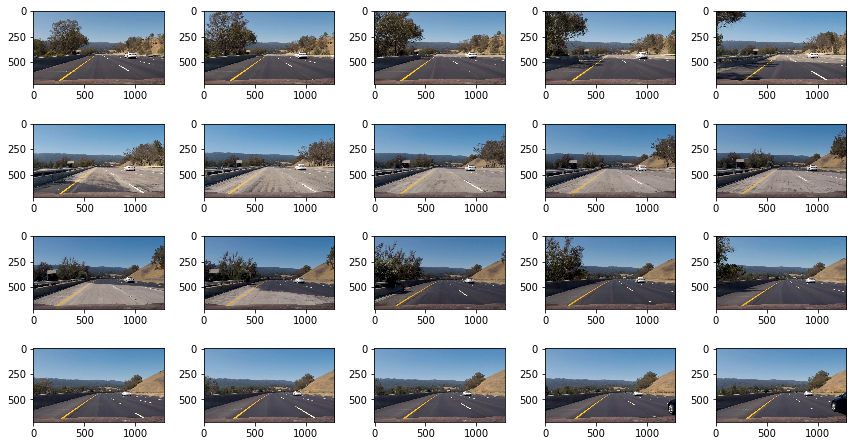

In [39]:
display_images(sample_video_imgs_np, start_idx=0, end_idx=200, step_val=10,
               columns=5, figsize=(12,64))

# Calibrate Camera

In [40]:
camera_cal_dir = 'camera_cal'

In [41]:
def load_camera_cal_images(camera_cal_dir):
    img_files = glob.glob('%s/*.jpg' % camera_cal_dir)
    return [imread(img_file) for img_file in img_files], img_files

In [42]:
camera_cal_img_arr, camera_cal_img_files = load_camera_cal_images(camera_cal_dir)

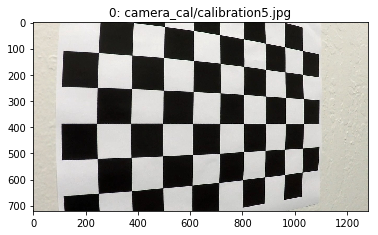

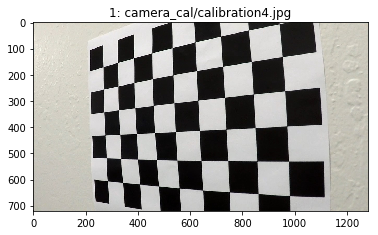

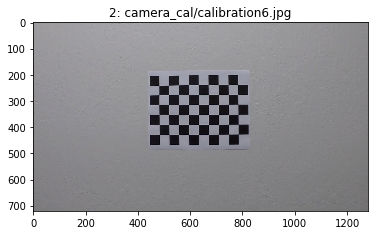

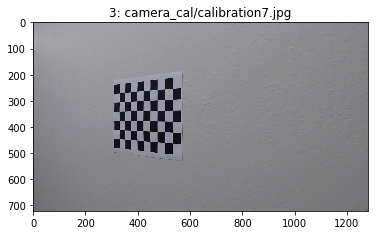

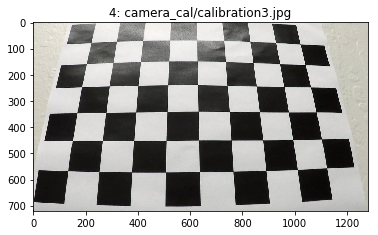

...

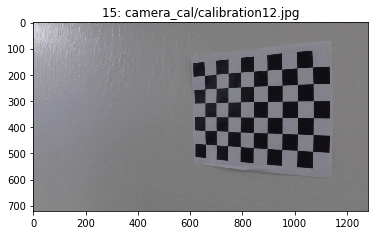

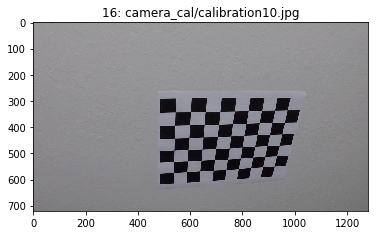

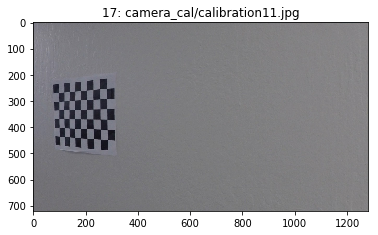

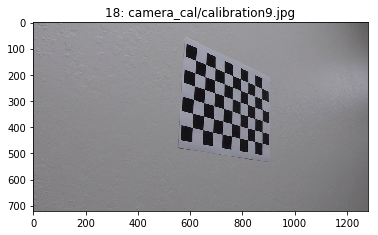

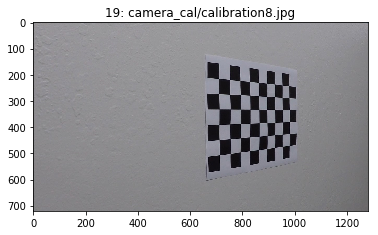

In [43]:
for i, camera_cal_img in enumerate(camera_cal_img_arr):
    plt.title('%d: %s' % (i, camera_cal_img_files[i]))
    plt.imshow(camera_cal_img)
    plt.show()

In [44]:
test_img = camera_cal_img_arr[6]
camera_cal_img_arr = [camera_cal_img_arr[i] for i in range(len(camera_cal_img_arr)) if i != 6]
camera_cal_img_files = [camera_cal_img_files [i] for i in range(len(camera_cal_img_files)) if i != 6]

In [45]:
objpoints = []
imgpoints = []

# termination criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
    
for img in tqdm(camera_cal_img_arr):
    x_cnt = 9
    y_cnt = 6

    objp = np.zeros((y_cnt*x_cnt,3), np.float32)
    objp[:,:2] = np.mgrid[0:x_cnt,0:y_cnt].T.reshape(-1,2)

    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    ret, corners = cv2.findChessboardCorners(gray, (y_cnt, x_cnt), None)

    if ret:
        objpoints.append(objp)
        cv2.cornerSubPix(gray,corners, (11,11), (-1,-1), criteria)
        imgpoints.append(corners)   
        
        """
        _img = img.copy()
        _img = cv2.drawChessboardCorners(_img, (y_cnt, x_cnt), corners, True)
        
        print(i)
        plt.imshow(img)
        plt.show()
        plt.imshow(_img)
        plt.show()
        """
        
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

"""
print("Ret:",ret)
print("Mtx:", mtx.shape, "\n", mtx)
print("Dist:",dist.shape, "\n", dist)
print("rvecs:",rvecs[0].shape, "\n", rvecs)
print("tvecs:",tvecs[0].shape, "\n", tvecs)
"""

100%|██████████| 19/19 [00:08<00:00,  1.94it/s]


'\nprint("Ret:",ret)\nprint("Mtx:", mtx.shape, "\n", mtx)\nprint("Dist:",dist.shape, "\n", dist)\nprint("rvecs:",rvecs[0].shape, "\n", rvecs)\nprint("tvecs:",tvecs[0].shape, "\n", tvecs)\n'

In [46]:
def cal_undistort(img, objpoints, imgpoints):
    # Use cv2.calibrateCamera() and cv2.undistort()
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, 
                                                        gray.shape[::-1], 
                                                        None, None)
    
    undist = cv2.undistort(img, mtx, dist, None, mtx)

    return undist

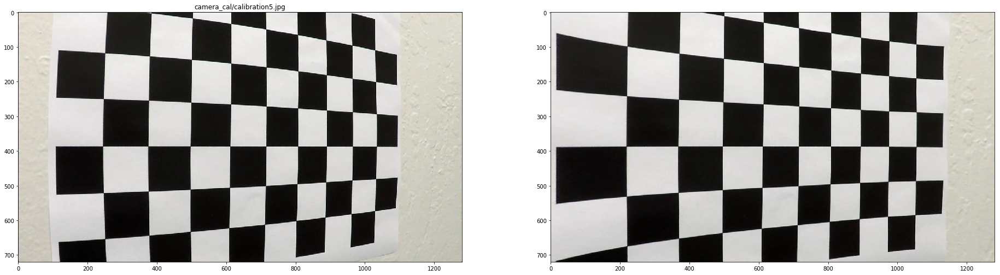

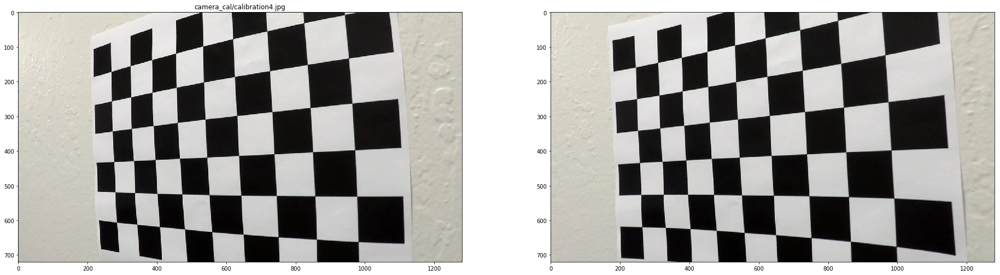

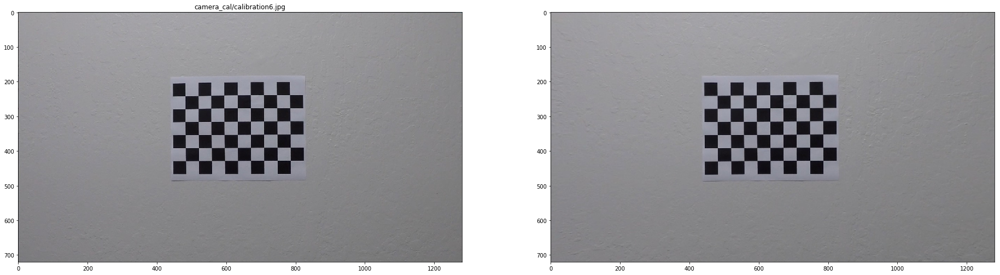

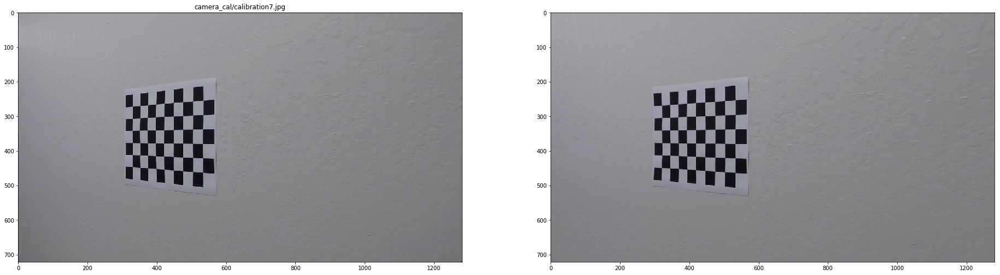

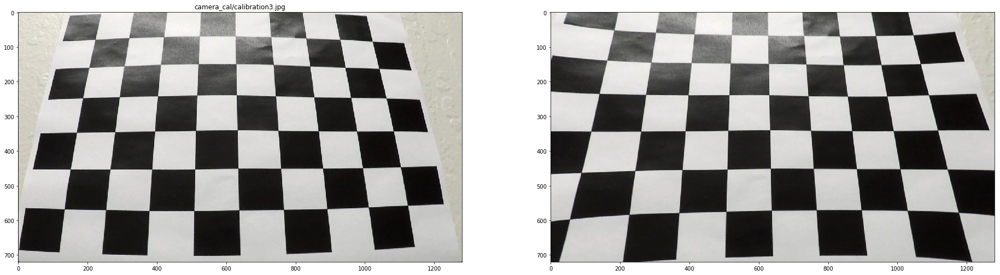

...

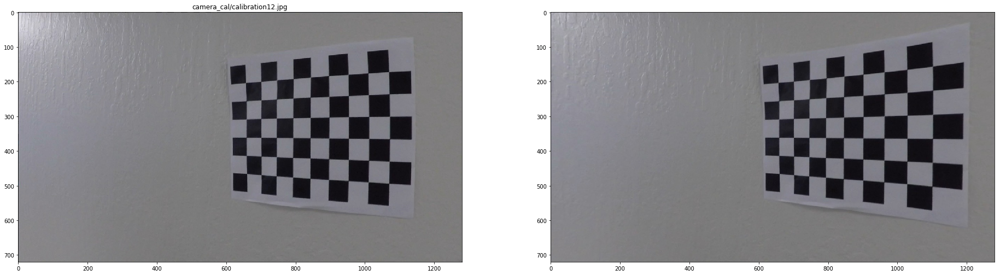

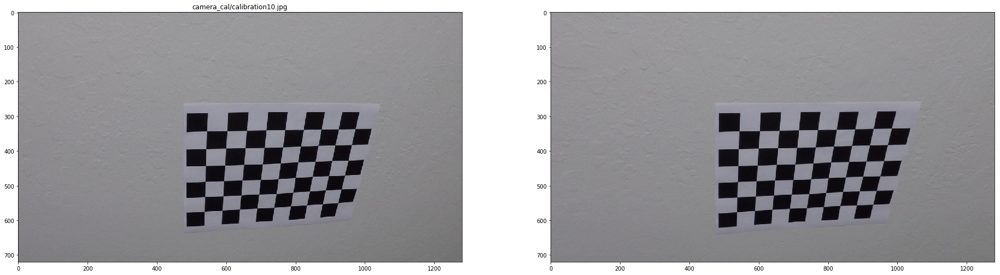

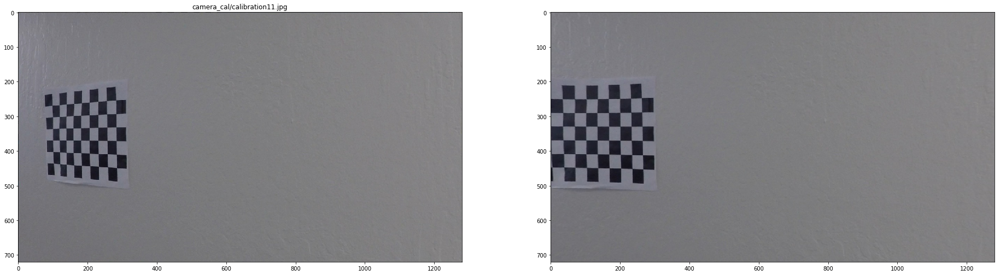

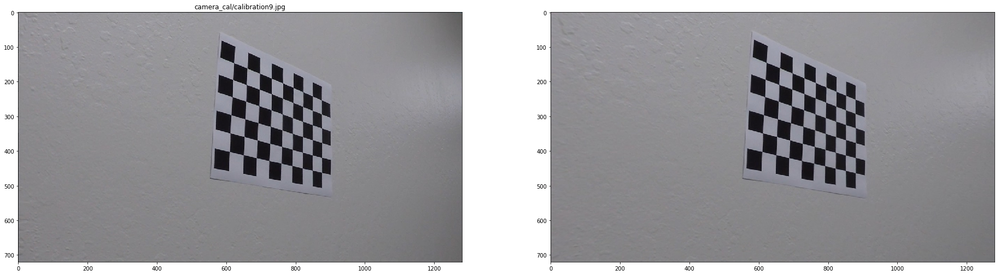

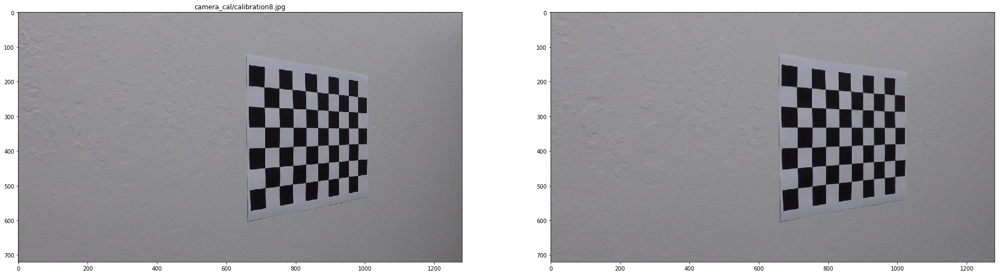

In [47]:
for i, img in enumerate(camera_cal_img_arr):
    undistorted_img = cal_undistort(img, objpoints, imgpoints)
    
    plt.figure(figsize=(32,32))

    plt.subplot(1,2,1)
    plt.title(camera_cal_img_files[i])
    plt.imshow(img)
    plt.subplot(1,2,2)
    plt.imshow(undistorted_img)
    plt.show()

In [78]:
type(objpoints[0])

numpy.ndarray

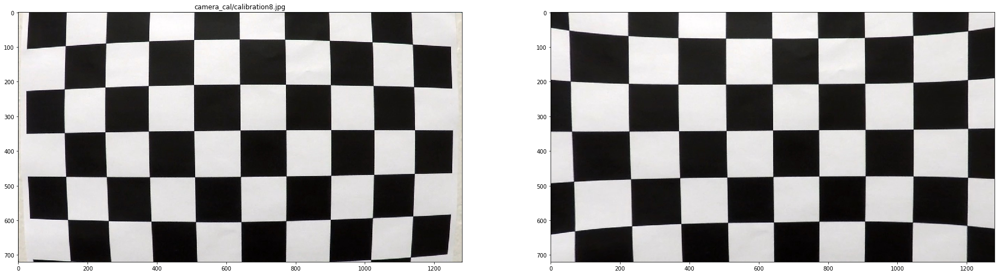

In [48]:
undistorted_img = cal_undistort(test_img, objpoints, imgpoints)
    
plt.figure(figsize=(32,32))

plt.subplot(1,2,1)
plt.title(camera_cal_img_files[i])
plt.imshow(test_img)
plt.subplot(1,2,2)
plt.imshow(undistorted_img)
plt.show()

# Pipeline

In [49]:
def load_test_images(test_img_dir):
    img_files = glob.glob('%s/*.jpg' % test_img_dir)
    return [imread(img_file) for img_file in img_files], img_files

In [50]:
test_image_arr, test_img_files = load_test_images('test_images')

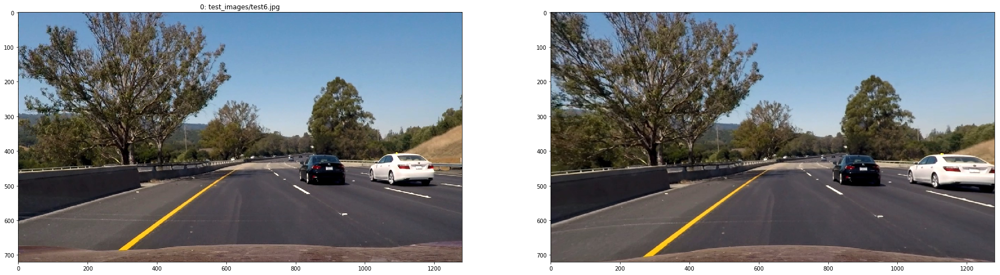

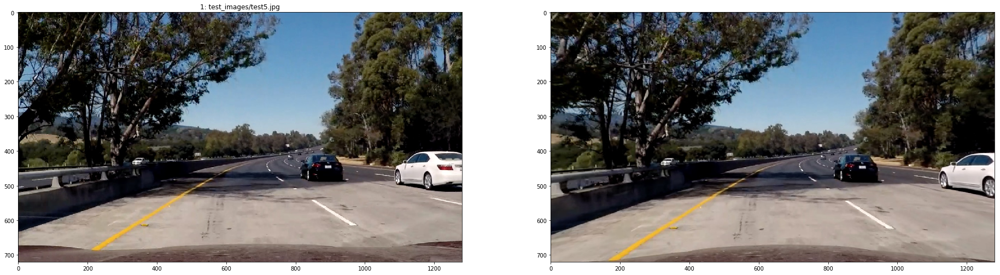

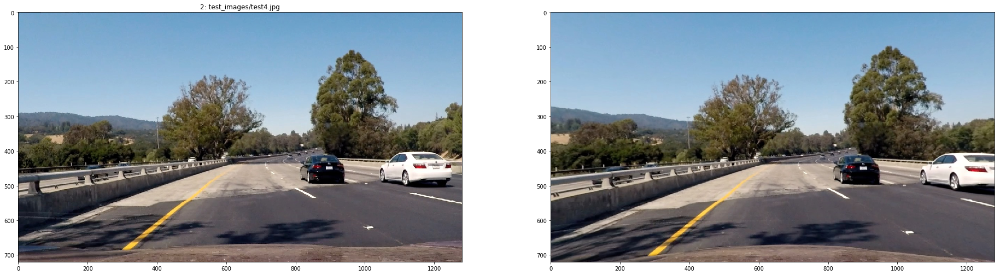

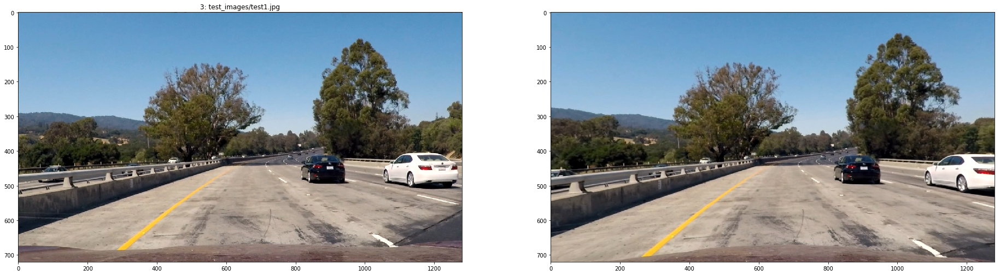

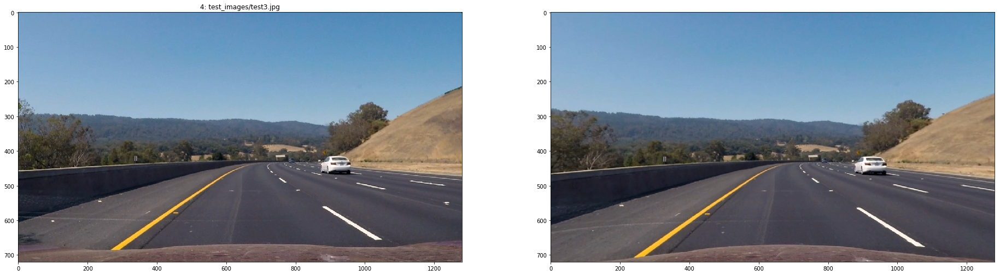

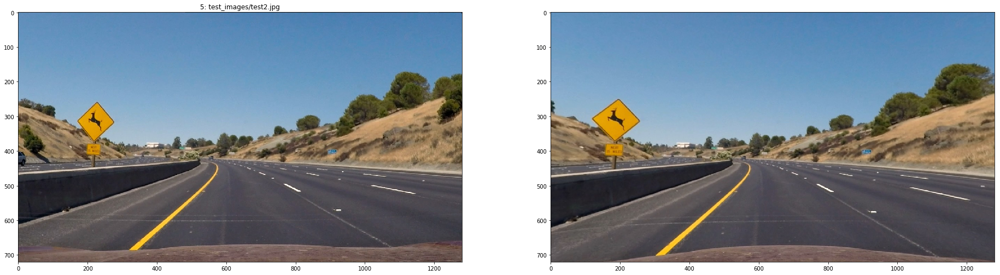

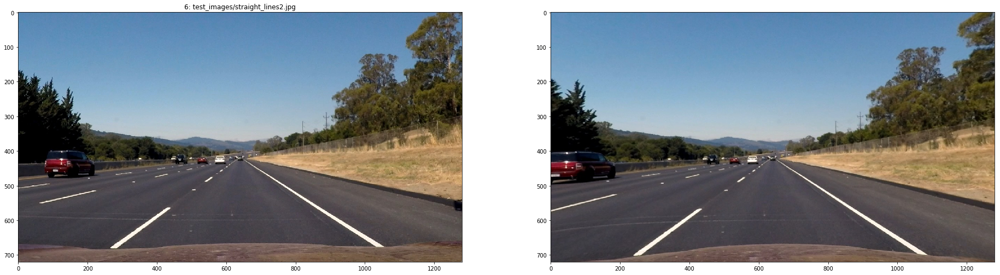

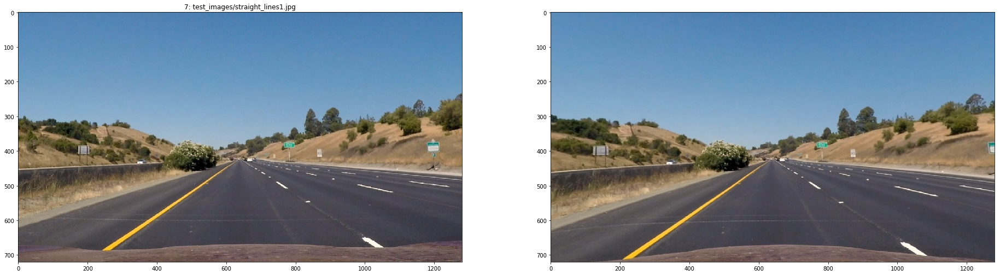

In [51]:
for i,img in enumerate(test_image_arr):
    undistorted_img = cal_undistort(img, objpoints, imgpoints)
    
    plt.figure(figsize=(32,32))
    
    plt.subplot(1,2,1)
    plt.title("%d: %s" % (i, test_img_files[i]))
    plt.imshow(img)
    plt.subplot(1,2,2)
    plt.imshow(undistorted_img)
    plt.show()

## Has the distortion correction been correcctly applied to each image?

In [54]:
test_road_img = test_image_arr[2]
undistorted_road_img = cal_undistort(test_road_img, objpoints, imgpoints)

In [55]:
gray_test_road_img = cv2.cvtColor(test_road_img, cv2.COLOR_RGB2GRAY)
gray_undistorted_road_img = cv2.cvtColor(undistorted_road_img, cv2.COLOR_RGB2GRAY)

height, width = gray_undistorted_road_img.shape
overlayed_test_img = np.zeros((height, width, 3))

overlayed_test_img[:,:,0] = gray_test_road_img
overlayed_test_img[:,:,1] = gray_undistorted_road_img

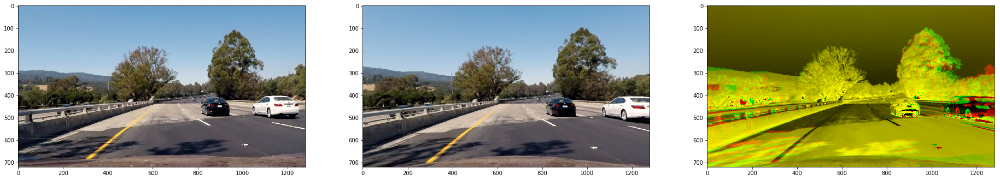

In [56]:
undistorted_road_img = cal_undistort(test_road_img, objpoints, imgpoints)
    
plt.figure(figsize=(32,32))
    
plt.subplot(1,3,1)
plt.imshow(test_road_img)
plt.subplot(1,3,2)
plt.imshow(undistorted_road_img)
plt.subplot(1,3,3)
plt.imshow(overlayed_test_img)
plt.show()

## 2. Has a binary image been created using color transforms, gradients or other methods?

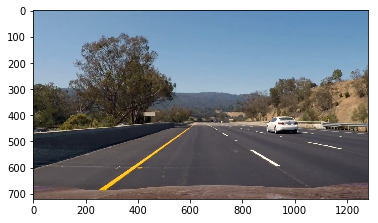

In [57]:
sample_video_img = sample_video_imgs_np[0]

plt.imshow(sample_video_img)
plt.show()

In [99]:
def canny(img, low_threshold, high_threshold):
    """Applies the Canny transform"""
    return cv2.Canny(img, low_threshold, high_threshold)

def gaussian_blur(img, kernel_size):
    """Applies a Gaussian Noise kernel"""
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


In [100]:
def crop_roi(img):
    """
    Crops region of interest for an image.  The cropped region is a preset trapezoidal shape
    based on the dimensions of the image.
    
    Parameters
    ----------
    img : numpy image array
        grayscale image

    Returns
    -------
    numpy image array
        cropped image based on img
    """
    bottom_y = img.shape[0]
    top_y = int(0.6*img.shape[0])
    top_left_x = int(0.45*img.shape[1])
    top_right_x = int(0.55*img.shape[1])
    bottom_left_x = int(0.1*img.shape[1])
    bottom_right_x = int(0.9*img.shape[1])

    pt0 = [bottom_left_x, bottom_y]
    pt1 = [top_left_x, top_y]
    pt2 = [top_right_x, top_y]
    pt3 = [bottom_right_x, bottom_y]
    
    bounding_box = np.array([pt0, pt1, pt2, pt3], np.int32)
    
    cropped_img = region_of_interest(img, [bounding_box])   
    
    return cropped_img

In [101]:
def weighted_img(img, initial_img, α=0.8, β=1., λ=0.):
    """
    `img` is the output of the hough_lines(), An image with lines drawn on it.
    Should be a blank image (all black) with lines drawn on it.
    
    `initial_img` should be the image before any processing.
    
    The result image is computed as follows:
    
    initial_img * α + img * β + λ
    NOTE: initial_img and img must be the same shape!
    """
    return cv2.addWeighted(initial_img, α, img, β, λ)

In [102]:
class Line(object):
    """
    Represents a line
    """
    def __init__(self, x1,y1,x2,y2):
        """
        Constructor for Line
        
        Parameters
        ----------
        x1, y1: int, int
            x,y of first point
        x2, y2: int, int
            x,y of second point
        """
        self.x1,self.y1,self.x2,self.y2 = x1,y1,x2,y2
        self._m = None
        self._b = None
        
    @property
    def m(self):
        """
        Slope of the line
        
        Returns
        -------
        float
            (y2-y1)/(x2-x1)
        """
        if self._m is None:
            if self.x2-self.x1 == 0:
                self._m = 0.0
            else:
                self._m = float(self.y2-self.y1)/float(self.x2-self.x1)
            
        return self._m
    
    @property
    def b(self):
        """
        x-intercept
        
        Returns
        -------
        float
            y1 - m*x1
        """
        if self._b is None:
            self._b = self.y1 - self.m*self.x1
            
        return self._b
    
    def find_x(self, y):
        """
        Based on y, find x.
        
        Parameters
        ----------
        y: int
            y coordinate
            
        Returns
        -------
        float
            corresponding x value
        """
        return (y-self.b)/self.m
    
    def find_y(self, x):
        """
        Based on x, find y.
        
        Parameters
        ----------
        x: int
            x coordinate
            
        Returns
        -------
        float
            corresponding y value
        """        
        return self.m*x + self.b

In [103]:
class LineCollection(object):
    """
    A collection of Lines.
    """
    def __init__(self, line_objs=[]):
        self.line_objs = line_objs
        self._mean_m = None
        self._mean_b = None
        self._top_y = None
        self._bottom_y = None
        
    @property
    def length(self):
        """
        Get number of lines.
        
        Returns
        -------
        int
            number of lines
        """
        return len(self.line_objs)
        
    @property
    def mean_m(self):
        """
        Get the mean slope of all lines.
        
        Returns
        -------
        float
            mean slope
        """
        if self._mean_m is None:
            if self.length == 0:
                self._mean_m = 0.0
            else:
                self._mean_m = float(np.mean([lo.m for lo in self.line_objs]))
            
        return self._mean_m
    
    @property
    def mean_b(self):
        """
        Get the mean x-intercept of all lines.
        
        Returns
        -------
        float
            mean x-intercept
        """
        if self._mean_b is None:
            if self.length == 0:
                self._mean_b = 0.0
            else:
                self._mean_b = float(np.mean([lo.b for lo in self.line_objs]))
            
        return self._mean_b
    
    @property
    def top_y(self):
        if self._top_y is None:
            min_y = None
        
            for line_obj in self.line_objs:
                if min_y is None or line_obj.y1 < min_y:
                    min_y = line_obj.y1
                    
                if min_y is None or line_obj.y2 < min_y:
                    min_y = line_obj.y2
            
            self._min_y = int(min_y)
            
        return self._top_y
    
    @property
    def bottom_y(self):
        """
        Find the bottom (furthest down) y value out of all lines.
        
        Returns
        -------
        int
            bottom y value
        """
        if self._bottom_y is None:
            max_y = 0
        
            for line_obj in self.line_objs:
                if line_obj.y1 > max_y:
                    max_y = line_obj.y1
                    
                if line_obj.y2 > max_y:
                    max_y = line_obj.y2
                
            self._bottom_y =  int(max_y)
            
        return self._bottom_y
    
    @property
    def top_y(self):
        """
        Find the top (furthest up) y value out of all lines.
        
        Returns
        -------
        int
            top y value
        """        
        if self._top_y is None:
            min_y = None
        
            for line_obj in self.line_objs:
                if min_y is None or line_obj.y1 < min_y:
                    min_y = line_obj.y1
                    
                if min_y is None or line_obj.y2 < min_y:
                    min_y = line_obj.y2
                
            if min_y is None:
                self._top_y = None
            else:
                self._top_y = int(min_y)
            
        return self._top_y
    
    def get_x(self, y):
        """
        Get x value based on the mean of the slope and x-intercept.
        
        Returns
        -------
        int
            x value
        """
        if self.mean_m == 0.0:
            return 0
       
        return int((y - self.mean_b)/self.mean_m)

    def get_mean_line_pts(self, bottom_y):
        """
        Get points for the mean line.  Extend the line to bottom_y.
        
        Parameters
        ----------
        bottom_y: int
            The bottom y for the line.
            
        Returns
        -------
        int, int, int, int
            Points for the line
        """
        if self.top_y is None:
            top_y = bottom_y
        else:
            top_y = self.top_y 
            
        top_x = self.get_x(top_y)
            
        bottom_x = self.get_x(bottom_y)
        return (top_x, top_y, bottom_x, bottom_y)

In [104]:
def find_lane3(image):
    """
    Like find_lane() but uses hough_lines3() instead of hough_lines().
    
    Parameters
    ----------
    image: numpy image array
        image of road
        
    Returns
    -------
    numpy image array
        image with black background with lane lines
    """    
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

    # Define a kernel size and apply Gaussian smoothing
    kernel_size = 5
    blur_gray = gaussian_blur(gray, kernel_size)

    # Define our parameters for Canny and apply
    low_threshold = 50
    high_threshold = 150
    edges = canny(blur_gray, low_threshold, high_threshold)

    masked_edges = crop_roi(edges)

    # Define the Hough transform parameters
    # Make a blank the same size as our image to draw on
    rho = 1 # distance resolution in pixels of the Hough grid
    theta = np.pi/180 # angular resolution in radians of the Hough grid
    threshold = 64    # minimum number of votes (intersections in Hough grid cell)
    
    min_line_length = 5 #minimum number of pixels making up a line
    max_line_gap = 100    # maximum gap in pixels between connectable line segments
    line_image = np.copy(image)*0 # creating a blank to draw lines on

    # Run Hough on edge detected image
    color_edges = hough_lines3(masked_edges, rho, theta, threshold, min_line_length, max_line_gap)
    
    # Draw the lines on the edge image
    lines_edges = cv2.addWeighted(color_edges, 0.8, line_image, 1, 0)   

    return lines_edges 

In [105]:
def draw_lines3(img, lines, color=[255, 0, 0], thickness=2):
    """
    Draw lines on original image.  The lines will be separated by left and right lines.
    Horizontal lines will be filtered out. The means of the left and right lines will 
    be used to draw the lines on the original image.
    
    Parameters
    ----------
    img: numpy image array
        original image
    lines: list of (x1,y1,x2,y2)
        list of line points
    color: array of int
        RGB values for drawn lines
    thickness: int
        thickness of the drawn lines
    """    
    line_objs = []
    for line in lines:
        for x1,y1,x2,y2 in line:
            curr_line_obj = Line(x1,y1,x2,y2)
            line_objs.append(curr_line_obj)
    
    left_line_objs = []
    right_line_objs = []
    for line_obj in line_objs:
        if abs(line_obj.m) > 0.5:
            if line_obj.m > 0.0:
                left_line_objs.append(line_obj)
            else:
                right_line_objs.append(line_obj)
            
    left_line_list = LineCollection(left_line_objs)
    right_line_list = LineCollection(right_line_objs)
    
    bottom_y = img.shape[0]
    
    mean_lines = [left_line_list.get_mean_line_pts(bottom_y), 
                  right_line_list.get_mean_line_pts(bottom_y)]

    for x1,y1,x2,y2 in mean_lines:
        cv2.line(img, (x1, y1), (x2,y2), color, thickness)

def hough_lines3(img, rho, theta, threshold, min_line_len, max_line_gap):
    """
    `img` should be the output of a Canny transform.
        
    Returns an image with hough lines drawn.
    """
    lines = cv2.HoughLinesP(img, rho, theta, threshold, np.array([]), minLineLength=min_line_len, maxLineGap=max_line_gap)
    line_img = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)
    draw_lines3(line_img, lines, thickness=8)
    return line_img

In [106]:
lane_line_sample_video_img = weighted_img(find_lane3(sample_video_img), sample_video_img)

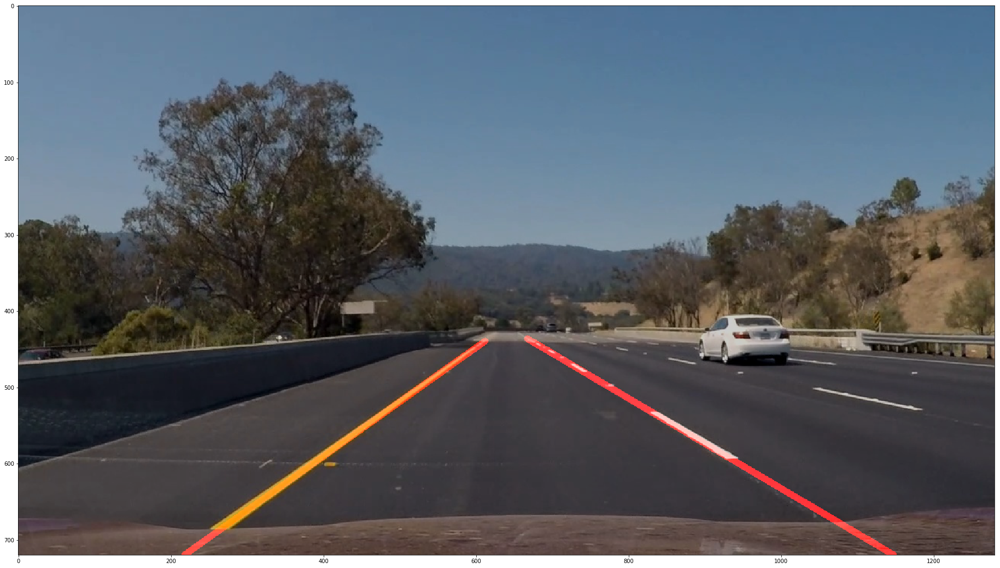

In [107]:
plt.figure(figsize=(32,32))
plt.imshow(lane_line_sample_video_img)
plt.show()

## 3. Has a perspective transform been applied to rectify the image?

In [122]:
def warp(img, src, dst):
    
        
    M = cv2.getPerspectiveTransform(src, dst)
        
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    
    return warped

In [380]:
img_size = (lane_line_sample_video_img.shape[1], lane_line_sample_video_img.shape[0])

"""
src = np.float32(
    [[(img_size[0] / 2) - 20, img_size[1] / 2 + 75],
    [((img_size[0] / 6) - 0), img_size[1]],
    [(img_size[0] * 5 / 6) + 75, img_size[1]],
    [(img_size[0] / 2 + 20), img_size[1] / 2 + 75]])
"""
src = np.float32(
     [[(img_size[0] / 2) - 58, img_size[1] / 2 + 100],
     [((img_size[0] / 6) - 5), img_size[1]],
     [(img_size[0] * 5 / 6) + 80, img_size[1]],
     [(img_size[0] / 2 + 70), img_size[1] / 2 + 100]])
dst = np.float32(
    [[(img_size[0] / 4), 0],
    [(img_size[0] / 4), img_size[1]],
    [(img_size[0] * 3 / 4), img_size[1]],
    [(img_size[0] * 3 / 4), 0]])    

In [382]:
warped_sample_video_img = warp(lane_line_sample_video_img, src, dst)

In [383]:
for i in range(src.shape[0]):
    print(src[i])

[ 582.  460.]
[ 208.33332825  720.        ]
[ 1146.66662598   720.        ]
[ 710.  460.]


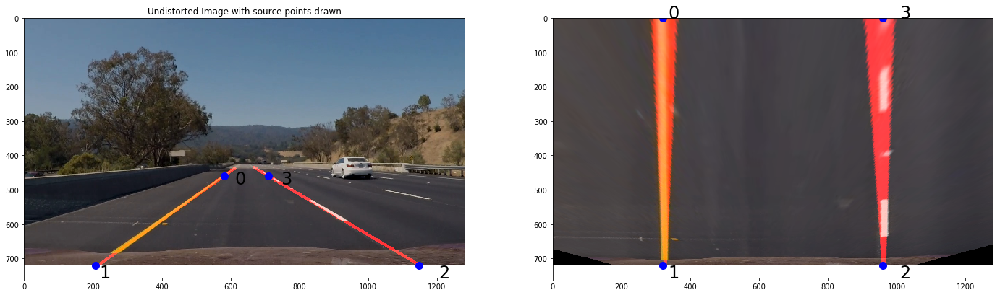

In [384]:
plt.figure(figsize=(24,32))

plt.subplot(1,2,1)
plt.title('Undistorted Image with source points drawn')
plt.imshow(lane_line_sample_video_img)
for i in range(src.shape[0]):
    x,y = src[i]
    plt.plot(x,y, 'bo', markersize=10)
    plt.text(x * (1.05), y * (1.05) , i, fontsize=24)
    
plt.subplot(1,2,2)
plt.imshow(warped_sample_video_img)
for i in range(dst.shape[0]):
    x,y = dst[i]
    plt.plot(x,y, 'bo', markersize=10)
    plt.text(x * (1.05), y * (1.05) , i, fontsize=24)

plt.show()